In [ ]:
# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [40]:
# Function to check and install specific package versions
def install_package(package, version):
    try:
        # Check the current version
        current_version = __import__(package).__version__

        # Special handling for torch to check for version with CUDA suffix
        if package == "torch":
            if current_version.startswith(version):
                print(f"{package} version {version} is already installed.")
                return
        else:
            if current_version == version:
                print(f"{package} version {version} is already installed.")
                return

        print(f"Uninstalling {package} version {current_version}...")
        !pip uninstall -y {package}
        print(f"Installing {package} version {version}...")
        !pip install {package}=={version}

    except ImportError:
        print(f"{package} not installed. Installing {package} version {version}...")
        !pip install {package}=={version}

# Specify the packages and their desired versions
packages = {
    "pandas": "2.2.2",
    "numpy": "1.26.4",
    "scikit-learn": "1.6.0",
    "torch": "2.5.1",
    "joblib": "1.4.2",
    "matplotlib": "3.10.0"
}

# Check and install packages
for pkg, ver in packages.items():
    install_package(pkg, ver)

# Import the necessary libraries after ensuring correct versions
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset, Subset
from sklearn.model_selection import KFold
import joblib
import matplotlib as mpl  # Import matplotlib for version checking
import matplotlib.pyplot as plt
from datetime import datetime, time
import random
from sklearn import __version__ as sklearn_version  # Import sklearn version
from torch.optim.lr_scheduler import StepLR
from torch.optim.lr_scheduler import ExponentialLR
import json

# Print package versions
print("pandas version:", pd.__version__)
print("numpy version:", np.__version__)
print("scikit-learn version:", sklearn_version)
print("torch version:", torch.__version__)
print("joblib version:", joblib.__version__)
print("matplotlib version:", mpl.__version__)
print("CUDA available:", torch.cuda.is_available())

pandas version 2.2.2 is already installed.
numpy version 1.26.4 is already installed.
scikit-learn not installed. Installing scikit-learn version 1.6.0...
torch version 2.5.1 is already installed.
joblib version 1.4.2 is already installed.
Uninstalling matplotlib version 3.7.5...
Found existing installation: matplotlib 3.10.0
Uninstalling matplotlib-3.10.0:
  Successfully uninstalled matplotlib-3.10.0
Installing matplotlib version 3.10.0...
  Using cached matplotlib-3.10.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (11 kB)
Using cached matplotlib-3.10.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (8.6 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ydata-profiling 4.12.1 requires matplotlib<3.10,>=3.5, but you have matplotlib 3.10.0 which is incompatible.
pandas version: 2.2.2
numpy version: 1.26.4
scikit-learn versio

In [41]:
# DETREND_WINDOW_SIZE = 2
BATCH_SIZE = 2048
WINDOW_SIZE = 50
LEARNING_RATE = 0.001  # From 0.001 to the best 0.0001
EPOCH_SIZE = 3 # 50
PREDICTION_LEN = 1   # Number of time steps to predict each time
K_FOLDS = 3 # 10  # Number of folds for cross-validation
TIME_INTERVAL_SEC = 60  # For 1 minute interval: 60
PREDICTION_TIMESTEP_SPAN = 0  # 14
NUM_PREDICTIONS = 15
MIN_SHADOW_PROPORTION = 0.0001  # 0.0005

In [42]:
# Load the JSON data
data = pd.read_json('/kaggle/input/spy-1min-regularhours/spy_1min_regularhours_truncated_semisupervised_preprocessed.json')

# Convert 'datetime' strings back to datetime objects
data['datetime'] = pd.to_datetime(data['datetime'])

## De-trend the data
#
# De-trending helps to remove any long-term trends or seasonality from the data,
# allowing the model to focus on the fluctuations that matter most for prediction.
#
# Why De-trend Before Normalization?
# Focus on Fluctuations:
# Normalizing data with trends can make it difficult for the model to learn meaningful patterns,
# as the model may focus on the trends rather than the actual relationships between features.
# Consistent Scale:
# By de-trending all relevant features, you ensure that they are on a similar scale, which can improve the learning process.
FEATURES_TO_DETREND = ['close', 'EMA_5', 'EMA_10', 'EMA_15', 'EMA_20']  #'open', 'high', 'low',
FEATURES_NOT_TO_DETREND = ['LONG_UPPER_SHADOW', 'LONG_LOWER_SHADOW', 'EMA_5_EMA_10', 'EMA_15_EMA_20', 'RSI', 'RSI_INT']
# FEATURES_NOT_TO_DETREND = ['RSI']
ALL_FEATURES = FEATURES_TO_DETREND + FEATURES_NOT_TO_DETREND

for feature in FEATURES_TO_DETREND:
    # SMA for de-trending
    #
    # Choosing the Window Size for Rolling Mean
    #
    # If your data has short-term fluctuations, a smaller DETREND_WINDOW_SIZE (e.g., 5-10)
    # might be more appropriate, allowing you to capture more immediate trends.
    # For longer-term trends, a larger DETREND_WINDOW_SIZE (e.g., 30-60) is often used
    # to smooth out more significant fluctuations and focus on overarching trends.
    #
    # Consider what you are trying to predict. If you are interested in short-term price movements,
    # a smaller window might be better. For long-term predictions, a larger window can help smooth out noise.
    #
    # If your goal is to analyze short-term trends without losing the fluctuations, you might consider using a very short window size (e.g., 2 or 3)
    # for a moving average. This would still smooth the data slightly but would retain more of the original fluctuations compared to larger windows.
    # data[f'{feature}_trend'] = data[feature].rolling(window=DETREND_WINDOW_SIZE).mean()  # Simple moving average
    # data[f'{feature}_detrended'] = data[feature] - data[f'{feature}_trend']

    # Differencing for de-trending
    data[f'{feature}_detrended'] = data[feature].diff()  # Calculate the difference from the previous value
data = data.dropna()    # Drop the first row which will be NaN due to differencing or drop NaN values created by rolling mean

## Normalize the de-trended features

# Define fixed scaler for RSI
class FixedRangeScaler:
    def __init__(self, feature_range=(0, 1), input_range=(0, 100)):
        self.feature_range = feature_range
        self.input_range = input_range

    def transform(self, X):
        X_std = (X - self.input_range[0]) / (self.input_range[1] - self.input_range[0])
        X_scaled = X_std * (self.feature_range[1] - self.feature_range[0]) + self.feature_range[0]
        return X_scaled

    def inverse_transform(self, X):
        X_std = (X - self.feature_range[0]) / (self.feature_range[1] - self.feature_range[0])
        X_original = X_std * (self.input_range[1] - self.input_range[0]) + self.input_range[0]
        return X_original

# Initialize scalers
dynamic_scaler = MinMaxScaler(feature_range=(0, 1))
long_upper_shadow_dynamic_scaler = MinMaxScaler(feature_range=(0, 1))
long_lower_shadow_dynamic_scaler = MinMaxScaler(feature_range=(0, 1))
rsi_scaler = FixedRangeScaler(feature_range=(0, 1), input_range=(0, 100))
rsi_int_scaler = FixedRangeScaler(feature_range=(0, 1), input_range=(-1, 1))

data = data.copy()  # Create a copy to avoid SettingWithCopyWarning
data[[f'{feature}_normalized' for feature in FEATURES_TO_DETREND]] = dynamic_scaler.fit_transform(
    data[[f'{feature}_detrended' for feature in FEATURES_TO_DETREND]].values
)
data['LONG_UPPER_SHADOW_normalized'] = long_upper_shadow_dynamic_scaler.fit_transform(data['LONG_UPPER_SHADOW'].values.reshape(-1, 1))
data['LONG_LOWER_SHADOW_normalized'] = long_lower_shadow_dynamic_scaler.fit_transform(data['LONG_LOWER_SHADOW'].values.reshape(-1, 1))
data['EMA_5_EMA_10_normalized'] = data['EMA_5_EMA_10']
data['EMA_15_EMA_20_normalized'] = data['EMA_15_EMA_20']
data['RSI_normalized'] = rsi_scaler.transform(data['RSI'].values.reshape(-1, 1))
data['RSI_INT_normalized'] = rsi_int_scaler.transform(data['RSI_INT'].values.reshape(-1, 1))

# Save the normalized and de-trended data for future use
# data.to_json('processed_data.json', orient='records')

# Save the scalers
joblib.dump(dynamic_scaler, '/kaggle/working/dynamic_scaler.pkl')
joblib.dump(long_upper_shadow_dynamic_scaler, '/kaggle/working/long_upper_shadow_dynamic_scaler.pkl')
joblib.dump(long_lower_shadow_dynamic_scaler, '/kaggle/working/long_lower_shadow_dynamic_scaler.pkl')
joblib.dump(rsi_scaler, '/kaggle/working/rsi_scaler.pkl')
joblib.dump(rsi_int_scaler, '/kaggle/working/rsi_int_scaler.pkl')

# Fit a dedicated scaler just for 'close'
close_dynamic_scaler = MinMaxScaler(feature_range=(0, 1))
data['close_normalized'] = close_dynamic_scaler.fit_transform(data[['close_detrended']].values)

# Save the close scaler
joblib.dump(close_dynamic_scaler, '/kaggle/working/close_dynamic_scaler.pkl')

['/kaggle/working/close_dynamic_scaler.pkl']

In [43]:
## Define a PyTorch Dataset
# Modified TimeSeriesDataset with strict day boundary checks for day-after-day training
class TimeSeriesDataset(Dataset):
    def __init__(self, data):
        self.sequence_length = WINDOW_SIZE
        self.prediction_length = PREDICTION_LEN

        # Convert the 'datetime' strings to numpy datetime64 for efficient processing
        self.dates = np.array([np.datetime64(dt) for dt in data['datetime']])

        # Extract features as numpy arrays
        self.features = np.stack([
            data[f'{feature}_normalized'].values
            for feature in ALL_FEATURES
        ], axis=1)  # Shape: (n_samples, n_features)

        # Store indices for each day
        unique_dates = np.unique(self.dates.astype('datetime64[D]'))
        print(f'unique_dates: {unique_dates}')
        print(f'unique_dates length: {len(unique_dates)}')
        self.daily_indices = {
            date: np.where(self.dates.astype('datetime64[D]') == date)[0] for date in unique_dates
        }

        # Pre-compute valid indices for each day
        self.valid_indices = []
        for date, day_indices in self.daily_indices.items():
            if len(day_indices) == 0:
                continue  # Skip if there are no indices for this date

            for i in range(len(day_indices)):
                seq_start = i
                seq_end = i + self.sequence_length
                target_start = seq_end + PREDICTION_TIMESTEP_SPAN
                target_end = target_start + self.prediction_length

                # Check if all indices are within the same day
                if target_end <= len(day_indices):
                    # Verify time continuity
                    if self._verify_time_continuity(day_indices, seq_start, seq_end, target_start, target_end):
                        self.valid_indices.append((
                            day_indices[seq_start:seq_end],
                            day_indices[target_start:target_end]
                        ))
        print(f'self.valid_indices head: {self.valid_indices[:10]}')
        print(f'self.valid_indices tail: {self.valid_indices[-10:]}')
        print(f'self.valid_indices length: {len(self.valid_indices)}')

    def _verify_time_continuity(self, day_indices, seq_start, seq_end, target_start, target_end):
        # Verify that times are continuous
        for j in range(seq_start, seq_end - 1):
            t1 = self.dates[day_indices[j]]
            t2 = self.dates[day_indices[j + 1]]
            if (t2 - t1).astype('timedelta64[s]') != TIME_INTERVAL_SEC:
                return False

        for j in range(target_start, target_end - 1):
            t1 = self.dates[day_indices[j]]
            t2 = self.dates[day_indices[j + 1]]
            if (t2 - t1).astype('timedelta64[s]') != TIME_INTERVAL_SEC:
                return False

        return True

    def __len__(self):
        # Total number of items across all days
        return len(self.valid_indices)

    def __getitem__(self, index):
        seq_indices, target_indices = self.valid_indices[index]

        # Return data in (features, sequence) format

        # Get input sequence
        x = self.features[seq_indices]  # Shape: (sequence_length, n_features)
        x = torch.tensor(x, dtype=torch.float32)

        # Get target sequence
        # Change in target extraction
        # y = self.features[target_indices]   # Target is now all normalized features for the next timestep(s)
        # y = torch.tensor(y, dtype=torch.float32)  # Shape: (prediction_length, n_features)
        y = self.features[target_indices][:, 0]  # Only extracting the 'close' price
        y = torch.tensor(y, dtype=torch.float32).view(-1, 1)  # Shape: (prediction_length, 1)

        return x, y

In [44]:
# Adding regularization can help prevent overfitting in your neural network,
# especially when you have a more complex model or when your dataset is small
#
# L1 (Lasso) adds a penalty equal to the absolute value of the magnitude of coefficients (weights) to the loss function.
# This can help with feature selection and simplify the model.
#
# L2 (Ridge) adds a penalty to the loss function based on the size of the weights.
# This can help keep the weights small and prevent overfitting.
#
# Using both L1 and L2 (often referred to as Elastic Net when combined) can leverage the advantages of both methods.
# L1 helps with feature selection, while L2 helps stabilize and improve the performance of the model by controlling the overall weight magnitude.
# Combining these techniques can lead to better generalization on unseen data.
# L1 helps to simplify the model, while L2 helps ensure the remaining features are well-weighted and not overly influenced by noise.
#
# Dropout randomly sets a fraction of input units to 0 during training,
# which prevents the network from becoming too reliant on any one feature and promotes redundancy in the network.
#
# Batch Normalization, a technique used to stabilize and accelerate training by normalizing the inputs to each layer.
# It helps maintain the mean and variance of activations within a certain range, making the training process more stable.

## Define a simple ANN model with three layers
class ANN(nn.Module):
    # The BATCH_SIZE is a parameter used during training and data loading, while the model itself is defined independently of
    # how many samples are processed at once. The model should be able to handle varying batch sizes dynamically during training and inference.
    def __init__(self):
        super(ANN, self).__init__()
        self.input_size = WINDOW_SIZE * len(ALL_FEATURES) # Input Layer
        # self.output_size = len(ALL_FEATURES) * PREDICTION_LEN # Output Layer with all normalized features
        self.output_size = PREDICTION_LEN # Output Layer with only the 'close' price

        # Modified to work with batch_first=True
        self.model = nn.Sequential(
            nn.Flatten(),  # Flattens input while preserving batch dimension

            # First Hidden Layer
            nn.Linear(self.input_size, 256),
            # nn.BatchNorm1d(256),
            nn.ReLU(),
            # nn.Dropout(0.2),
            # nn.Linear(256, self.output_size),

            # Second Hidden Layer
            nn.Linear(256, 128),
            # nn.BatchNorm1d(128),
            nn.ReLU(),
            # nn.Dropout(0.2),
            nn.Linear(128, self.output_size),

            # Third hidden layer
            # nn.Linear(128, 64),
            # nn.BatchNorm1d(64),
            # nn.ReLU(),
            # nn.Dropout(0.2),
            # nn.Linear(64, self.output_size),

            nn.Sigmoid()  # Add this if you want outputs between 0 and 1
        )
        # The choice of layer sizes (256 and 128) is somewhat arbitrary and depends on the design of the neural network.
        # Typically, you start with a larger number of neurons (256) in the first hidden layer to capture more complex patterns
        # and then reduce the number of neurons in subsequent layers (128) to refine those patterns.
        # If you reversed them (using 128 for the first layer and 256 for the second), the network could still work,
        # but it might not learn as effectively due to having fewer neurons in the first layer to capture the initial complexity.

    def forward(self, x):
        # Input shape: (batch_size, sequence_length, n_features)
        batch_size = x.size(0)
        output = self.model(x.reshape(batch_size, -1))
        # Reshape to (batch_size, prediction_length, n_features)
        return output.view(batch_size, PREDICTION_LEN, -1)
        # batch_size = x.size(0) refers to the number of samples in the current batch. This may or may not equal BATCH_SIZE,
        # depending on the specific batch processed during training. If the last batch is smaller than BATCH_SIZE,
        # then batch_size will be less than BATCH_SIZE.

In [45]:
## Train the model
def train_with_validation(model, train_loader, val_loader, criterion, optimizer, epochs=EPOCH_SIZE):
    # Modified training with model state saving
    best_val_loss = float('inf')
    best_fold_state = None
    patience = 5
    patience_counter = 0
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)

    # Learning rate scheduler
    # scheduler = StepLR(optimizer, step_size=10, gamma=0.1)
    # scheduler = ExponentialLR(optimizer, gamma=0.9)

    # Adaptive Learning Rate Adjustment
    # prev_val_loss = float('inf')
    # min_lr = 1e-6  # Minimum learning rate
    # max_lr = 1e-2  # Maximum learning rate

    for epoch in range(epochs):
        print(f'Epoch {epoch + 1}/{epochs}')

        # Training phase
        model.train()
        train_loss = 0
        for x_batch, y_batch in train_loader:
            x_batch = x_batch.to(device, non_blocking=True)  # non_blocking=True for async transfer
            y_batch = y_batch.to(device, non_blocking=True)

            optimizer.zero_grad()
            outputs = model(x_batch)
            loss = criterion(outputs, y_batch)

            # L1 regularization
            # l1_lambda = 1e-5
            # l1_norm = sum(p.abs().sum() for p in model.parameters())
            # loss = loss + l1_lambda * l1_norm

            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        # Validation phase
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x_batch, y_batch in val_loader:
                x_batch = x_batch.to(device, non_blocking=True)  # non_blocking=True for async transfer
                y_batch = y_batch.to(device, non_blocking=True)
                outputs = model(x_batch)
                val_loss += criterion(outputs, y_batch).item()

        avg_train_loss = train_loss / len(train_loader)
        avg_val_loss = val_loss / len(val_loader)

        print(f'Train Loss: {avg_train_loss:.8f}, Validation Loss: {avg_val_loss:.8f}')

        # Adaptive Learning Rate Adjustment
        # new_learning_rate = 0
        # if avg_val_loss < prev_val_loss:
        #     # Increase learning rate by 10%
        #     for param_group in optimizer.param_groups:
        #         param_group['lr'] = min(param_group['lr'] * 1.1, max_lr)  # Ensure it doesn't exceed max_lr
        #         new_learning_rate = param_group['lr']
        #     print(f'Learning Rate: {new_learning_rate}')
        # else:
        #     # Decrease learning rate by 50%
        #     for param_group in optimizer.param_groups:
        #         param_group['lr'] = max(param_group['lr'] * 0.5, min_lr)  # Ensure it doesn't go below min_lr
        #         new_learning_rate = param_group['lr']
        #     print(f'Learning Rate: {new_learning_rate}')
        # prev_val_loss = avg_val_loss

        # Step the learning rate scheduler
        # scheduler.step()
        # print(f'Learning Rate: {scheduler.get_last_lr()[0]}')

        # Early stopping logic
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            best_fold_state = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                break

    return best_val_loss, best_fold_state

In [46]:
def split_dates_into_folds():
    # Get unique dates and sort them
    unique_dates = sorted(set(pd.to_datetime(data['datetime']).dt.date))
    total_dates = len(unique_dates)

    # Calculate size of each fold
    fold_size = total_dates // K_FOLDS

    # Create non-overlapping folds
    folds = []
    for i in range(K_FOLDS):
        start_idx = i * fold_size
        end_idx = start_idx + fold_size if i < K_FOLDS - 1 else total_dates
        fold_dates = unique_dates[start_idx:end_idx]
        folds.append(fold_dates)

    return folds

In [47]:
def cross_validate():
    full_dataset = TimeSeriesDataset(data)
    folds = split_dates_into_folds()

    best_overall_loss = float('inf')
    best_overall_state = None
    all_fold_losses = []  # To store losses for each fold

    for fold_idx in range(K_FOLDS):
        # Use current fold as validation, all others as training
        val_dates = set(folds[fold_idx])
        # Shuffle the fold indices except the current fold_idx
        fold_indices = list(range(K_FOLDS))
        fold_indices.remove(fold_idx)
        random.shuffle(fold_indices)
        train_dates = set()
        for i in fold_indices:
            train_dates.update(folds[i])

        print(f'Fold {fold_idx + 1}:')
        print(f'Training dates: from {min(train_dates)} to {max(train_dates)}')
        print(f'Validation dates: from {min(val_dates)} to {max(val_dates)}')

        # Split indices
        train_indices = []
        val_indices = []
        for idx, (seq_indices, target_indices) in enumerate(full_dataset.valid_indices):
            date = pd.to_datetime(data.iloc[seq_indices[0]]['datetime']).date()
            if date in train_dates:
                train_indices.append(idx)
            elif date in val_dates:
                val_indices.append(idx)

        print(f'Training samples: {len(train_indices)}, Validation samples: {len(val_indices)}')

        train_dataset = Subset(full_dataset, train_indices)
        val_dataset = Subset(full_dataset, val_indices)

        # Create data loaders for train and validation splits
        train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=False)
        val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

        # Initialize a new model, criterion, and optimizer for each fold
        model = ANN()
        criterion = nn.MSELoss()
        # criterion = nn.SmoothL1Loss()  # Huber loss
        # criterion = nn.L1Loss()
        # def msle_loss(outputs, targets):
        #     return torch.mean((torch.log(outputs + 1) - torch.log(targets + 1)) ** 2)
        # criterion = msle_loss
        # def custom_loss(outputs, targets):
        #     mse_loss = nn.MSELoss()(outputs, targets)
        #     mae_loss = nn.L1Loss()(outputs, targets)
        #     return 0.7 * mse_loss + 0.3 * mae_loss
        # criterion = custom_loss
        optimizer = torch.optim.Adam(  # Changed from Adam to AdamW for weight_decay (L2)
            model.parameters(),
            lr=LEARNING_RATE,
            # weight_decay=1e-5   # If needed, increase the weight_decay (L2) from 1e-5 to 1e-4
        )

        # Train and validate the model
        best_fold_loss, best_fold_state = train_with_validation(
            model,
            train_loader,
            val_loader,
            criterion,
            optimizer
        )

        all_fold_losses.append(best_fold_loss)  # Store loss for this fold
        print(f'Validation Loss for fold {fold_idx+1}: {best_fold_loss:.8f}')

        # Save the best model
        if best_fold_loss < best_overall_loss:
            best_overall_loss = best_fold_loss
            best_overall_state = best_fold_state

    # Print the results
    print('\nCross-validation complete!')
    print(f'Average validation loss: {np.mean(all_fold_losses):.8f}')
    print(f'Standard deviation: {np.std(all_fold_losses):.8f}')

    # Save the best model
    torch.save(best_overall_state, '/kaggle/working/best_model_cv.pth')

    # Plotting the validation losses
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, K_FOLDS + 1), all_fold_losses, marker='o', linestyle='-')
    plt.title('Validation Loss Across Folds')
    plt.xlabel('Fold Number')
    plt.ylabel('Validation Loss')
    plt.xticks(range(1, K_FOLDS + 1))
    plt.grid()
    plt.savefig('/kaggle/working/cross_validation_loss.png')  # Save the plot as an image
    plt.close()  # Close the plot to free up memory

    return best_overall_state, best_overall_loss

In [48]:
# Perform cross-validation
best_overall_state, best_overall_loss = cross_validate()

# Create a final model with the best weights
# final_model = ANN()
# final_model.load_state_dict(best_overall_state)

print(f'\nBest model saved with validation loss: {best_overall_loss:.8f}')

unique_dates: ['2016-05-26' '2016-05-27' '2016-05-31' ... '2024-05-24' '2024-05-28'
 '2024-05-29']
unique_dates length: 2015
self.valid_indices head: [(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]), array([50])), (array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]), array([51])), (array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
       36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51]), array([52])), (array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 

In [49]:
# Load the saved scalers
dynamic_scaler = joblib.load('/kaggle/working/dynamic_scaler.pkl')
long_upper_shadow_dynamic_scaler = joblib.load('/kaggle/working/long_upper_shadow_dynamic_scaler.pkl')
long_lower_shadow_dynamic_scaler = joblib.load('/kaggle/working/long_lower_shadow_dynamic_scaler.pkl')
rsi_scaler = joblib.load('/kaggle/working/rsi_scaler.pkl')
rsi_int_scaler = joblib.load('/kaggle/working/rsi_int_scaler.pkl')
close_dynamic_scaler = joblib.load('/kaggle/working/close_dynamic_scaler.pkl')

In [50]:
# Load the trained model
model = ANN()
if torch.cuda.is_available():
    model.load_state_dict(torch.load('/kaggle/working/best_model_cv.pth', weights_only=True))
else:
    model.load_state_dict(torch.load('/kaggle/working/best_model_cv.pth', map_location=torch.device('cpu'), weights_only=True))
model.eval()  # Set the model to evaluation mode

# Preprocess the new input JSON file
def preprocess_new_data(df):
    # De-trend the features
    for feature in FEATURES_TO_DETREND:
        # SMA for de-trending
        # df[f'{feature}_trend'] = df[feature].rolling(window=DETREND_WINDOW_SIZE).mean()
        # df[f'{feature}_detrended'] = df[feature] - df[f'{feature}_trend']

        # Differencing for de-trending
        df[f'{feature}_detrended'] = df[feature].diff()  # Calculate the difference from the previous value
    df = df.dropna()    # Drop the first row which will be NaN due to differencing or drop NaN values created by rolling mean

    # Use the saved scalers to transform the detrended data
    # (The same minimum and maximum values from the training dataset to normalize the prediction dataset)
    detrended_features = df[[f'{feature}_detrended' for feature in FEATURES_TO_DETREND]].values
    normalized_features = dynamic_scaler.transform(detrended_features)

    df = df.copy()  # Create a copy to avoid SettingWithCopyWarning
    # Assign normalized values back to DataFrame
    for i, feature in enumerate(FEATURES_TO_DETREND):
        df[f'{feature}_normalized'] = normalized_features[:, i]
    # Normalize separately
    df['LONG_UPPER_SHADOW_normalized'] = long_upper_shadow_dynamic_scaler.transform(df['LONG_UPPER_SHADOW'].values.reshape(-1, 1))
    df['LONG_LOWER_SHADOW_normalized'] = long_lower_shadow_dynamic_scaler.transform(df['LONG_LOWER_SHADOW'].values.reshape(-1, 1))
    df['EMA_5_EMA_10_normalized'] = df['EMA_5_EMA_10']
    df['EMA_15_EMA_20_normalized'] = df['EMA_15_EMA_20']
    df['RSI_normalized'] = rsi_scaler.transform(df['RSI'].values.reshape(-1, 1))
    df['RSI_INT_normalized'] = rsi_int_scaler.transform(df['RSI_INT'].values.reshape(-1, 1))

    return df

# Create a dataset for predictions based on the new data
def create_prediction_dataset(new_df):
    last_sequence = new_df[[f'{feature}_normalized' for feature in ALL_FEATURES]].iloc[-WINDOW_SIZE:].values
    return torch.tensor(last_sequence, dtype=torch.float32).unsqueeze(0)  # Add batch dimension

# Modified the EMA and RSI calculations since they were originally designed for actual price values rather than detrended values.
# When working with detrended data, the traditional interpretations of EMA and RSI need to be adjusted because:
# - Detrended values oscillate around zero
# - The magnitude of changes is different from actual prices
# - Negative values are common in detrended data

def calculate_ema_for_sequence(values, period):
    alpha = 2 / (period + 1)
    values = np.array(values)
    res = np.zeros_like(values)
    res[0] = values[0]

    # Use the same ewm formula as pandas
    for i in range(1, len(values)):
        res[i] = alpha * values[i] + (1 - alpha) * res[i-1]

    return res[-1]  # Return the last EMA value

def calculate_rsi_for_sequence(diff_values, period=7):
    values = np.array(diff_values)

    # Calculate price changes
    changes = np.diff(values)
    changes = np.append(0, changes)  # Add 0 at the beginning to maintain length

    # Separate gains and losses
    # gains = np.where(changes > 0, changes, 0)
    # losses = np.where(changes < 0, -changes, 0)
    # For detrended data, we compare to zero instead of previous value
    gains = np.where(values > 0, values, 0)
    losses = np.where(values < 0, -values, 0)

    # Calculate EMA multiplier
    alpha = 2 / (period + 1)

    # Initialize average gains and losses
    avg_gains = np.zeros_like(gains)
    avg_losses = np.zeros_like(losses)

    # Set first values (SMA for the first period)
    if len(gains) >= period:
        avg_gains[period-1] = np.mean(gains[:period])
        avg_losses[period-1] = np.mean(losses[:period])

        # Calculate EMA for the rest
        for i in range(period, len(gains)):
            avg_gains[i] = alpha * gains[i] + (1 - alpha) * avg_gains[i-1]
            avg_losses[i] = alpha * losses[i] + (1 - alpha) * avg_losses[i-1]
    else:
        avg_gains[:len(gains)] = np.mean(gains)  # Handle cases with insufficient data
        avg_losses[:len(losses)] = np.mean(losses)

    # Handle division by zero
    rs = avg_gains / np.where(avg_losses == 0, 1e-10, avg_losses)
    rsi = 100 - (100 / (1 + rs))

    # Ensure RSI stays within bounds
    return np.clip(rsi[-1], 0, 100)

def smooth_predictions(predictions, alpha=0.7):
    smoothed = predictions.copy()
    for i in range(1, len(predictions)):
        smoothed[i] = alpha * predictions[i] + (1 - alpha) * smoothed[i-1]
    return smoothed

# Make predictions using the trained model
def predict_trends(df):
    # Validation checks
    # print(len(df))
    if len(df) < WINDOW_SIZE:
        raise ValueError(f"Input data must have at least {WINDOW_SIZE} rows")
    # Check if all required features are present
    required_features = ALL_FEATURES
    missing_features = [f for f in required_features if f not in df.columns]
    if missing_features:
        raise ValueError(f"Missing required features: {missing_features}")

    preprocessed_df = preprocess_new_data(df)
    prediction_dataset = create_prediction_dataset(preprocessed_df)

    all_predictions = []

    # Make predictions for the specified number of future rows
    with torch.no_grad():
        # Make predictions for the specified number of future rows
        current_sequence = prediction_dataset
        # Recursive forecasting
        #
        # Potential Drawbacks
        # Error Propagation: If the model makes an inaccurate first prediction,
        # that error can propagate through subsequent predictions, potentially leading to larger inaccuracies.
        # Uncertainty: Each subsequent prediction may become less reliable, especially as the forecast horizon increases.
        for _ in range(NUM_PREDICTIONS):
            # Print the shape of the current sequence before making a prediction
            # print("Current sequence shape:", current_sequence.shape)  # Debugging line

            # Get the model's prediction
            pred = model(current_sequence).numpy()

            # Predict all features
            # all_predictions.append(pred.flatten())

            # Predict only the close prices
            # pred_close = pred.flatten()[0]
            # Denormalize the predicted close price using the first column of dynamic_scaler
            denorm_pred = close_dynamic_scaler.inverse_transform(pred.reshape(1, -1))[0][0]
            # Get the last close prices from the current sequence
            current_close_prices = current_sequence[0, :, 0].numpy()  # Extract the 'close' prices
            # Denormalize the current close prices using the second to last columns of dynamic_scaler
            denorm_current_close_prices = close_dynamic_scaler.inverse_transform(current_close_prices.reshape(-1, 1))[:, 0]
            # print(denorm_current_close_prices)
            denorm_closes = denorm_current_close_prices.tolist() + [denorm_pred]
            # Calculate new features using actual prices
            new_features = np.zeros(len(ALL_FEATURES))
            new_features[0] = denorm_pred

            # Calculate EMAs using pandas' ewm equivalent method
            new_features[1] = calculate_ema_for_sequence(denorm_closes, 5)    # EMA_5
            new_features[2] = calculate_ema_for_sequence(denorm_closes, 10)   # EMA_10
            new_features[3] = calculate_ema_for_sequence(denorm_closes, 15)   # EMA_15
            new_features[4] = calculate_ema_for_sequence(denorm_closes, 20)   # EMA_20
            # Normalize the price-based features
            price_features = new_features[0:5].reshape(1, -1)
            new_features[0:5] = dynamic_scaler.transform(price_features)[0]
            # Calculate and normalize shadow features
            # Since we don't have OHLC data for future predictions, using placeholder values
            upper_shadow = np.array([[0]])  # placeholder
            lower_shadow = np.array([[0]])  # placeholder
            new_features[5] = long_upper_shadow_dynamic_scaler.transform(upper_shadow)[0][0]
            new_features[6] = long_lower_shadow_dynamic_scaler.transform(lower_shadow)[0][0]
            # EMA crossover signals (no scaling needed, binary values)
            new_features[7] = 1 if new_features[1] > new_features[2] else 0  # EMA_5_EMA_10
            new_features[8] = 1 if new_features[3] > new_features[4] else 0  # EMA_15_EMA_20
            # Calculate and normalize RSI
            rsi = calculate_rsi_for_sequence(denorm_closes[-8:], 7)
            # Boundary check for RSI
            if rsi < 0 or rsi > 100:
                print(f"Warning: RSI value {rsi} outside normal range")
                rsi = max(0, min(100, rsi)) # Clamp RSI to valid range
            new_features[9] = rsi_scaler.transform(np.array([[rsi]]))[0][0]
            # Calculate and normalize RSI_INT
            if rsi >= 70:
                rsi_int = 1
            elif rsi <= 30:
                rsi_int = -1
            else:
                rsi_int = 0
            new_features[10] = rsi_int_scaler.transform(np.array([[rsi_int]]))[0][0]

            all_predictions.append(new_features)

            # Predict only one close price
            # all_predictions.append(pred.flatten())

            # print("Prediction shape:", pred.shape)  # Debugging line

            # Update sequence by dropping the oldest PREDICTION_LEN entries
            # and adding the new predictions
            # next_input = np.concatenate((current_sequence.numpy().flatten()[PREDICTION_LEN * len(ALL_FEATURES):], pred.flatten())) # [1:] Drops the first element (the oldest data point) while keeping the rest of the sequence intact
            next_input = np.concatenate((current_sequence.numpy().flatten()[PREDICTION_LEN * len(ALL_FEATURES):], new_features))
            # current_sequence = torch.tensor(next_input, dtype=torch.float32).unsqueeze(0)
            current_sequence = torch.tensor(next_input, dtype=torch.float32).reshape(1, WINDOW_SIZE, len(ALL_FEATURES))

    # Convert predictions to numpy array
    predictions_array = np.array(all_predictions)
    # print("All predictions shape:", predictions_array.shape)  # Debugging line

    ## The predicted_trends need to be both trended and denormalized because:
    # Data Processing Flow:
    # Original data → Detrended → Normalized → Model Input
    # Model Output → Denormalized → Trended → Final Prediction

    # Process each feature with its corresponding scaler
    final_predictions = {}

    # Process FEATURES_TO_DETREND
    detrended_predictions = predictions_array[:, :len(FEATURES_TO_DETREND)]
    denormalized = dynamic_scaler.inverse_transform(detrended_predictions)
    for i, feature in enumerate(FEATURES_TO_DETREND):
        last_value = df[feature].iloc[-1]
        trended_values = [last_value]

        for diff in denormalized[:, i]:
            next_value = trended_values[-1] + diff
            trended_values.append(next_value)

        final_predictions[feature] = np.array(trended_values[1:])

    # Process FEATURES_NOT_TO_DETREND

    # Shadow features
    final_predictions['LONG_UPPER_SHADOW'] = long_upper_shadow_dynamic_scaler.inverse_transform(
        predictions_array[:, 5].reshape(-1, 1)).flatten()
    final_predictions['LONG_LOWER_SHADOW'] = long_lower_shadow_dynamic_scaler.inverse_transform(
        predictions_array[:, 6].reshape(-1, 1)).flatten()
    # EMA comparison features (no inverse transform needed)
    final_predictions['EMA_5_EMA_10'] = predictions_array[:, 7]
    final_predictions['EMA_15_EMA_20'] = predictions_array[:, 8]
    # RSI features
    final_predictions['RSI'] = rsi_scaler.inverse_transform(
        predictions_array[:, 9].reshape(-1, 1)).flatten()
    final_predictions['RSI_INT'] = rsi_int_scaler.inverse_transform(
        predictions_array[:, 10].reshape(-1, 1)).flatten()

    # Apply smoothing to numerical features
    # for feature in FEATURES_TO_DETREND + ['RSI']:
    #     final_predictions[feature] = smooth_predictions(final_predictions[feature])

    return final_predictions

<ipython-input-51-1c33cc3767de>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 7), sharex=True)


backtest_sample_size: 167, hit_count: 92, hit_rate: 0.5508982035928144


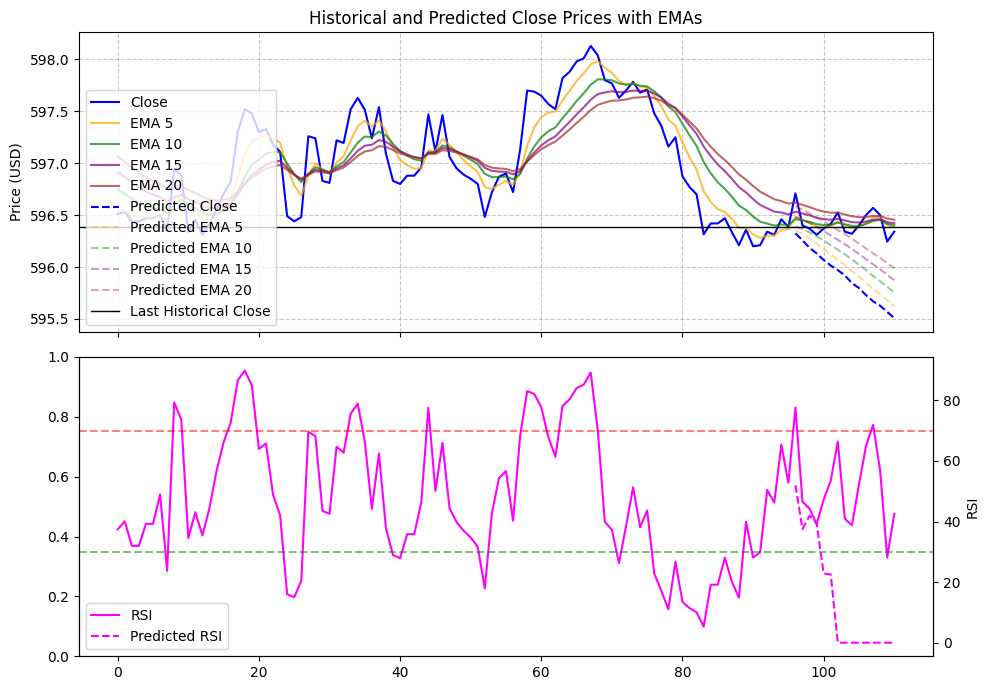

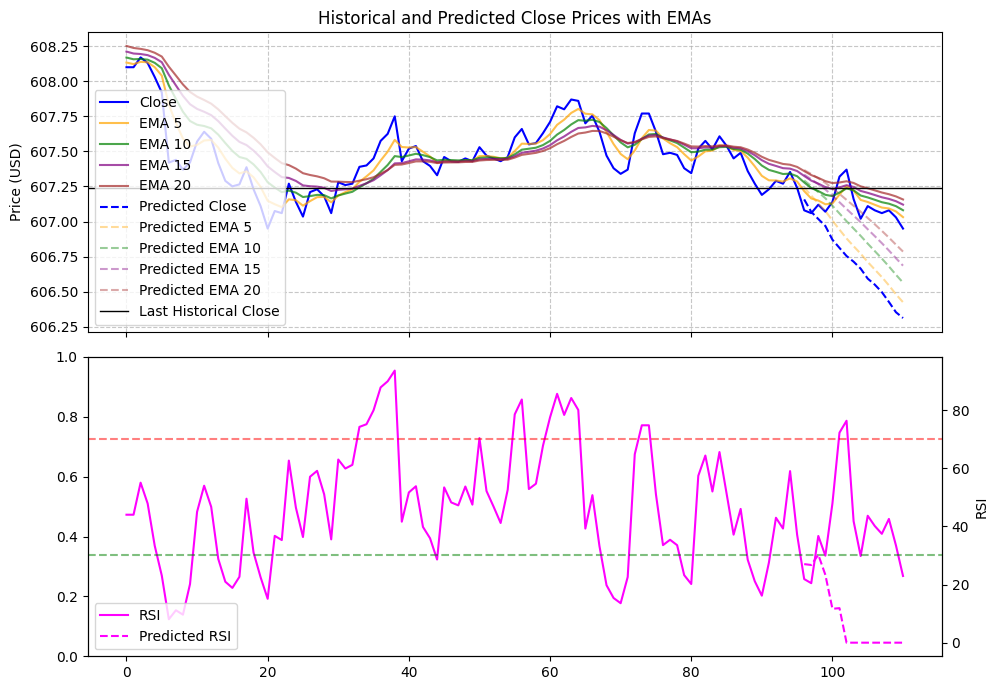

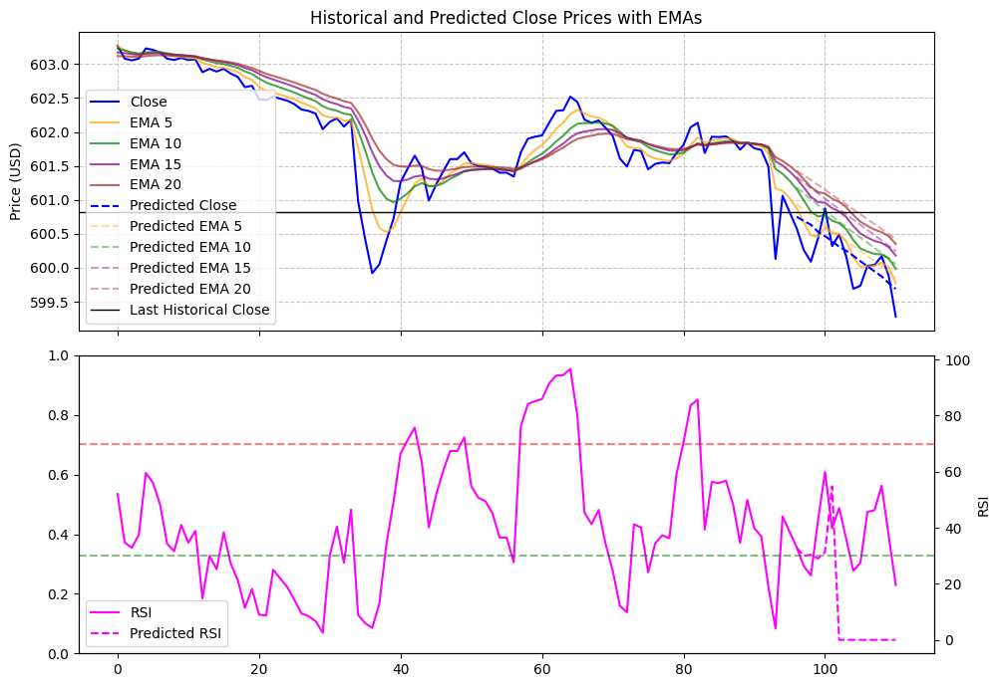

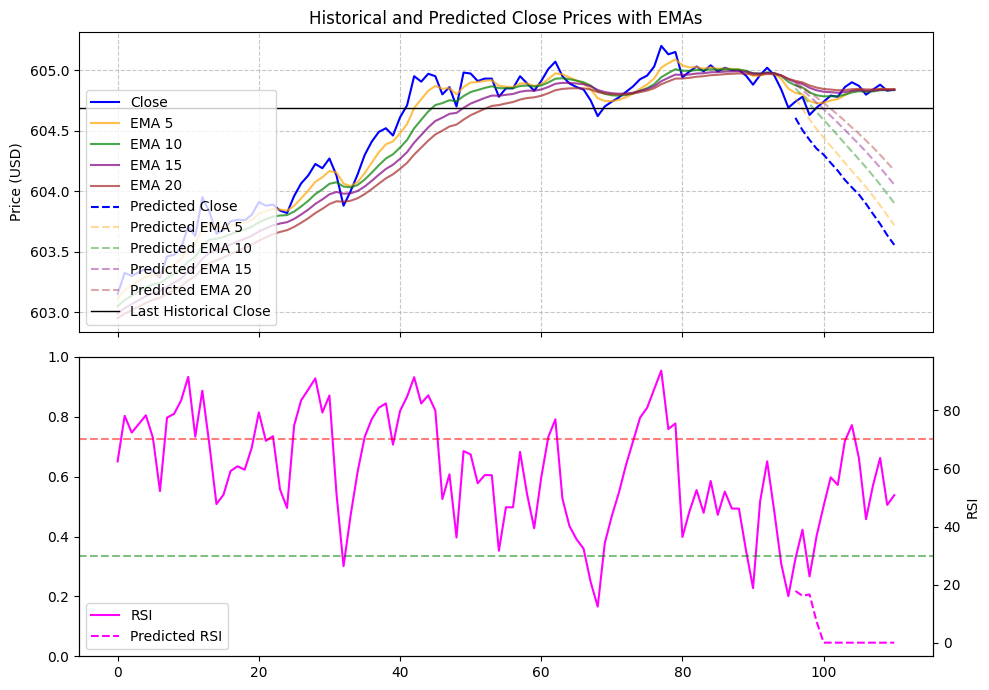

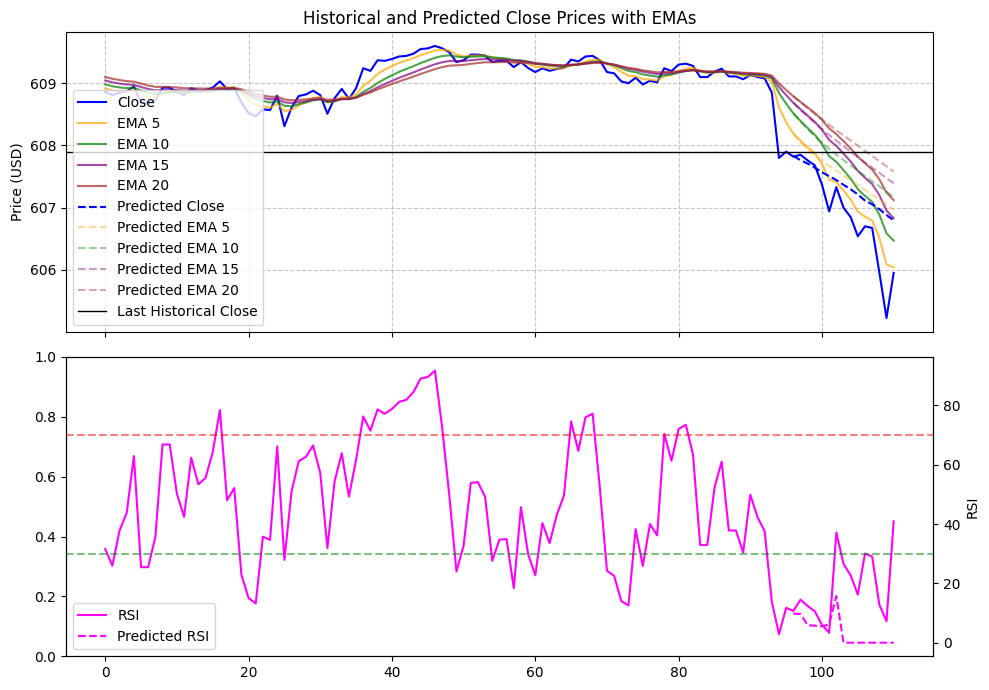

...

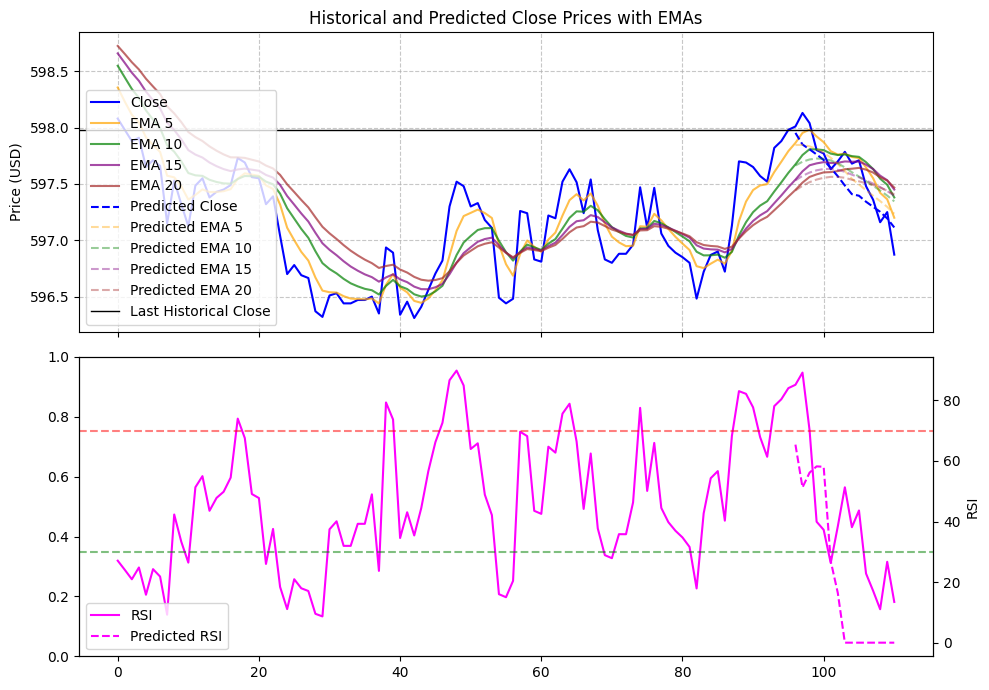

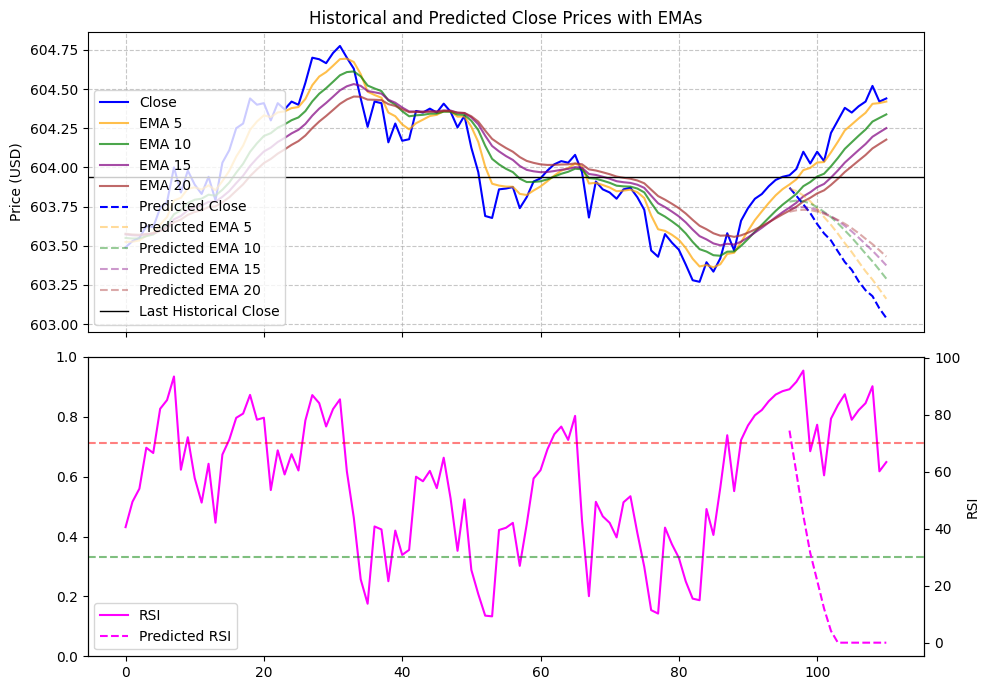

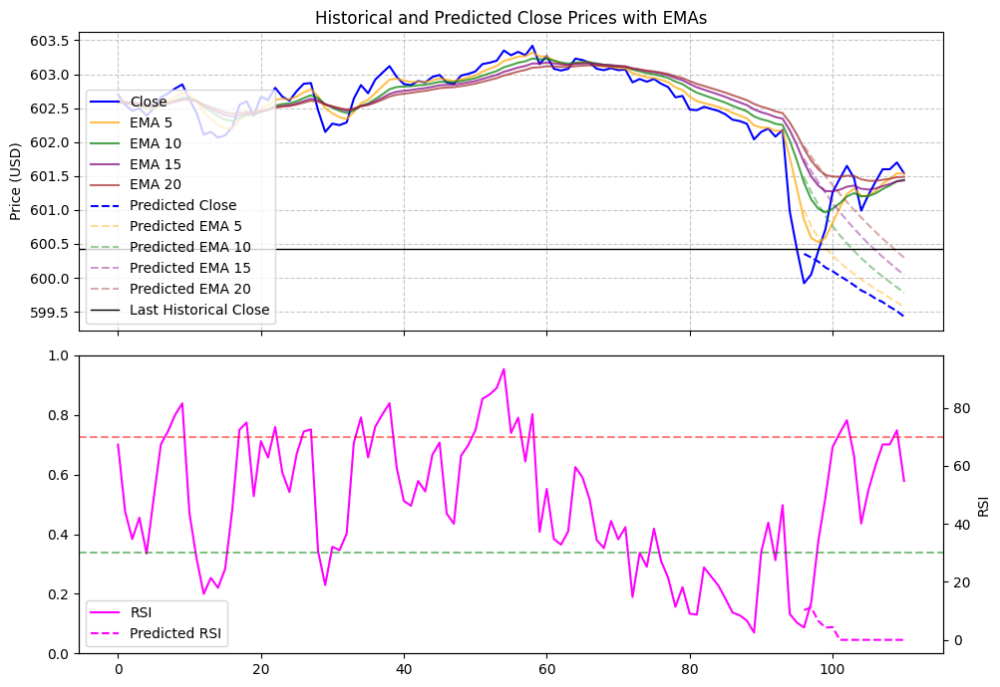

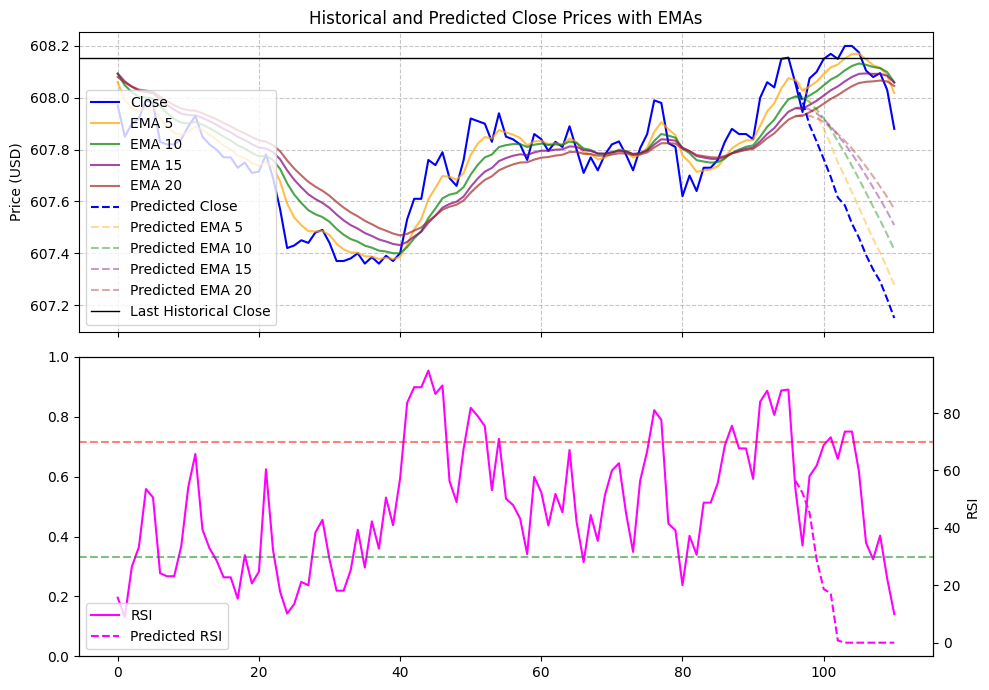

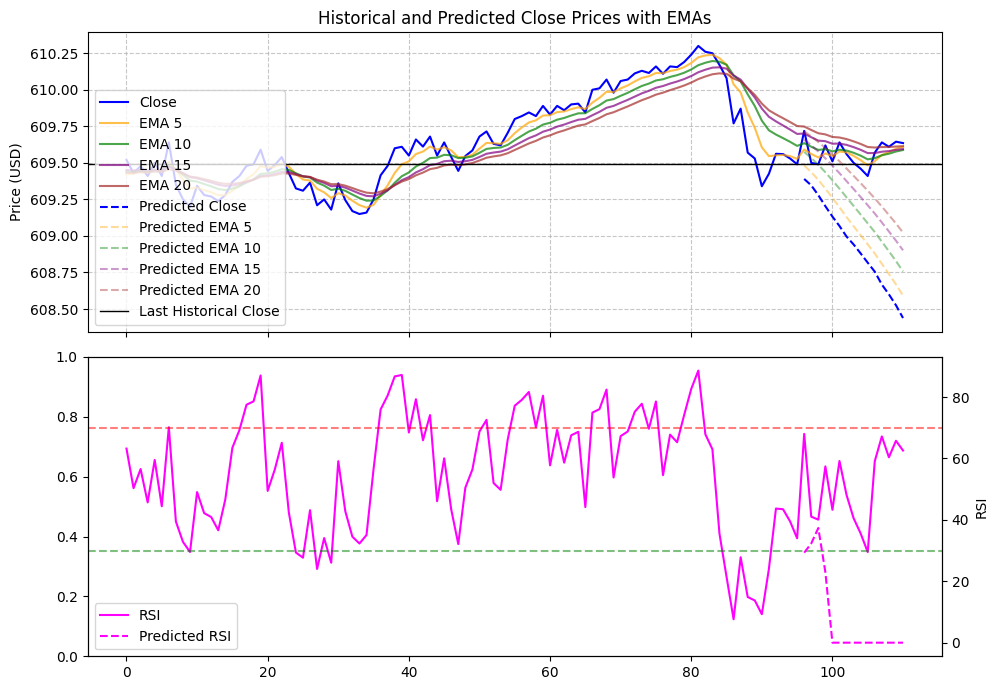

In [51]:
import os

# Directory containing the JSON files
directory = '/kaggle/input/historical-111-with-extended-60/backtest'

json_files = [f for f in os.listdir(directory) if f.endswith('.json')]
backtest_sample_size = len(json_files)
hit_count = 0

# Loop through all JSON files in the directory
for filename in json_files:
    # Construct the full file path
    file_path = os.path.join(directory, filename)
    # Convert JSON file to DataFrame
    backtest_df = pd.read_json(file_path)

    prediction_df = backtest_df.iloc[:-NUM_PREDICTIONS]
    prediction_df = prediction_df.copy()
    # print(prediction_df.tail())

    predicted_trends = predict_trends(prediction_df)
    # print(predicted_trends)

    # Prepare x-axis values (using index for simplicity)
    time_index = np.arange(len(backtest_df))

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 7), sharex=True)

    # Historical close prices
    ax1.plot(time_index, backtest_df['close'], label='Close', color='blue')

    # Predicted close prices
    if PREDICTION_TIMESTEP_SPAN > 0:
        SPAN = PREDICTION_TIMESTEP_SPAN + 1
    else:
        SPAN = PREDICTION_TIMESTEP_SPAN
    future_index = np.arange(len(backtest_df) - (len(predicted_trends['close']) + PREDICTION_TIMESTEP_SPAN), len(backtest_df))
    # print(len(backtest_df))
    # print(len(predicted_trends['close']) + PREDICTION_TIMESTEP_SPAN + 1)
    # print(len(future_index))
    # print(future_index)

    # Historical EMAs
    ax1.plot(time_index, backtest_df['EMA_5'], label='EMA 5', color='orange', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_10'], label='EMA 10', color='green', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_15'], label='EMA 15', color='purple', alpha=0.7)
    ax1.plot(time_index, backtest_df['EMA_20'], label='EMA 20', color='brown', alpha=0.7)

    predicted_last_close_price = predicted_trends['close'][-1]
    # Extend predicted_trends to match future_index
    if PREDICTION_TIMESTEP_SPAN > 0:
        num_future_points = len(future_index)
        # Create new arrays for the extended predictions
        extended_close = np.full(num_future_points, predicted_last_close_price)
        # Plot the predicted close prices
        ax1.plot(future_index, extended_close, label='Predicted Close', color='blue', linestyle='--')
    else:
        # Plot the predicted close prices
        ax1.plot(future_index, predicted_trends['close'], label='Predicted Close', color='blue', linestyle='--')
        # Predicted EMAs (using lighter colors)
        ax1.plot(future_index, predicted_trends['EMA_5'], label='Predicted EMA 5', color='orange', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_10'], label='Predicted EMA 10', color='green', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_15'], label='Predicted EMA 15', color='purple', alpha=0.4, linestyle='--')
        ax1.plot(future_index, predicted_trends['EMA_20'], label='Predicted EMA 20', color='brown', alpha=0.4, linestyle='--')

    # Add a horizontal line for the last historical close price
    last_close_price = prediction_df['close'].iloc[-1]
    ax1.axhline(y=last_close_price, color='black', linestyle='-', linewidth=1, label='Last Historical Close')

    # Add a title and labels to the axes
    ax1.set_title('Historical and Predicted Close Prices with EMAs')
    ax1.set_ylabel('Price (USD)')
    ax1.grid(True, linestyle='--', alpha=0.7)
    ax1.legend(loc='lower left')

    # Add a second y-axis for RSI
    plt_rsi = ax2.twinx()
    plt_rsi.plot(time_index, backtest_df['RSI'], label='RSI', color='magenta', linestyle='-')
    plt_rsi.axhline(70, linestyle='--', alpha=0.5, color='red')
    plt_rsi.axhline(30, linestyle='--', alpha=0.5, color='green')

    # Predicted RSI (using a lighter color)
    if PREDICTION_TIMESTEP_SPAN <= 0:
        plt_rsi.plot(future_index, predicted_trends['RSI'], label='Predicted RSI', color='magenta', linestyle='--')
    plt_rsi.set_ylabel('RSI')
    plt_rsi.legend(loc='lower left')

    # Final adjustments and save the plot
    plt.tight_layout()
    plt.savefig(f'/kaggle/working/{filename}_plot.png')

    actual_close_price = backtest_df['close'].iloc[-1]
    # Determine the price direction for actual vs last close
    if actual_close_price > last_close_price:
        actual_direction = 'up'
    else:
        actual_direction = 'down'

    # Determine the price direction for actual vs predicted last close
    if predicted_last_close_price > last_close_price:
        predicted_direction = 'up'
    else:
        predicted_direction = 'down'

    # Increment hit_count if both directions are the same
    if actual_direction == predicted_direction:
        hit_count += 1

hit_rate = hit_count / backtest_sample_size
print(f'backtest_sample_size: {backtest_sample_size}, hit_count: {hit_count}, hit_rate: {hit_rate}')

## About the debugging printout

# Why are the following shapes torch.Size([1, 450]) and not torch.Size([1, 50, 9])?
# The shape torch.Size([1, 450]) arises after you concatenate the previous sequence with the new predictions. Here’s the relevant line of code:
# Current Sequence: Initially, current_sequence has the shape [1, 50, 9]. This means 1 batch, 50 time steps, and 9 features.
# Flattening: When you call .numpy().flatten(), it converts the tensor into a flat array, resulting in a shape of [450] (since 50 * 9 = 450).
# Concatenation: After you concatenate the flattened sequence with the predictions, you're left with a single-dimensional tensor of shape [450].

# What are the 'Prediction shape: (1, 1, 9)'?
# The shape (1, 1, 9) indicates that your model is producing one prediction for each feature in your output layer:
# Batch Size: The first 1 indicates that you're processing one batch.
# Time Steps: The second 1 indicates that you're predicting one time step ahead.
# Number of Features: The last 9 indicates that there are 9 features being predicted (which includes both the detrended features and the RSI).

# Why is 'All predictions shape: (9, 9)'?
# The shape (9, 9) for predictions_array indicates that you have made 9 predictions, each containing 9 features